In [12]:
import gc
import os
from pathlib import Path
import random
import sys

from tqdm.notebook import tqdm
import numpy as np
import pandas as pd
import scipy as sp

import matplotlib.pyplot as plt
import seaborn as sns

from IPython.core.display import display, HTML

# --- plotly ---
from plotly import tools, subplots
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.express as px
import plotly.figure_factory as ff
import plotly.io as pio
pio.templates.default = "plotly_dark"

# --- models ---
from sklearn import preprocessing
from sklearn.model_selection import KFold
import lightgbm as lgb
import xgboost as xgb
import catboost as cb

# --- setup ---
pd.set_option('max_columns', 50)

In [4]:
# visuallize the data
def plot_image(map_type, ax, agent=False):
    cfg["raster_params"]["map_type"] = map_type
    rast = build_rasterizer(cfg, dm)
    if agent:
        dataset = AgentDataset(cfg, zarr_dataset, rast)
    else:
        dataset = EgoDataset(cfg, zarr_dataset, rast)
    scene_idx = 2
    indexes = dataset.get_scene_indices(scene_idx)
    images = []
    for idx in indexes:    
        data = dataset[idx]
        im = data["image"].transpose(1, 2, 0)
        im = dataset.rasterizer.to_rgb(im)
        target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
        center_in_pixels = np.asarray(cfg["raster_params"]["ego_center"]) * cfg["raster_params"]["raster_size"]
        draw_trajectory(im, target_positions_pixels, TARGET_POINTS_COLOR, yaws=data["target_yaws"])
        clear_output(wait=True)
        ax.imshow(im[::-1])
                
def animate_solution(images):
    def animate(i):
        im.set_data(images[i]) 
    fig, ax = plt.subplots()
    im = ax.imshow(images[0])    
    return ani.FuncAnimation(fig, animate, frames=len(images), interval=60)

def animation(type_):
    cfg["raster_params"]["map_type"] = type_
    rast = build_rasterizer(cfg, dm)
    dataset = EgoDataset(cfg, zarr_dataset, rast)
    scene_idx = 34
    indexes = dataset.get_scene_indices(scene_idx)
    images = []
    for idx in indexes:    
        data = dataset[idx]
        im = data["image"].transpose(1, 2, 0)
        im = dataset.rasterizer.to_rgb(im)
        target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
        center_in_pixels = np.asarray(cfg["raster_params"]["ego_center"]) * cfg["raster_params"]["raster_size"]
        draw_trajectory(im, target_positions_pixels, TARGET_POINTS_COLOR, yaws=data["target_yaws"])
        clear_output(wait=True)
        images.append(PIL.Image.fromarray(im[::-1]))
    anim = animate_solution(images)
    return HTML(anim.to_jshtml())

In [13]:
from IPython.display import display, clear_output
import PIL


# Originally from https://www.kaggle.com/jpbremer/lyft-scene-visualisations by @jpbremer
# Modified following:
#  - Added to show timestamp
#  - Do not show image, to only show animation.
#  - Use blit=True.

def animate_solution(images, timestamps=None):
    def animate(i):
        changed_artifacts = [im]
        im.set_data(images[i])
        if timestamps is not None:
            time_text.set_text(timestamps[i])
            changed_artifacts.append(im)
        return tuple(changed_artifacts)

    
    fig, ax = plt.subplots()
    im = ax.imshow(images[0])
    if timestamps is not None:
        time_text = ax.text(0.02, 0.95, "", transform=ax.transAxes)

    anim = animation.FuncAnimation(fig, animate, frames=len(images), interval=60, blit=True)
    
    # To prevent plotting image inline.
    plt.close()
    return anim

In [21]:
dm =LocalDataManager()
dataset_path = dm.require('../../../kaggle_data/lyft/scenes/sample.zarr')

FileNotFoundError: ../../../kaggle_data/lyft/scenes/sample.zarr is not present in local data folder ../input/lyft-motion-prediction-autonomous-vehicles

In [23]:
ls ../../../

ARAI/                 kaggle_data/
CV_challenge/         kagglecompete/
Dockerfile/           merge_path/
docker_cmpark.sh*     tf_efficientnetnoise_letter_v6softmaxmodel/
docker_tf_cmpark.sh*


In [5]:
from l5kit.data import ChunkedDataset, LocalDataManager
from l5kit.dataset import EgoDataset, AgentDataset
dm = LocalDataManager()
dacfget_path = dm.require(cfg["val_data_loader"]["key"]);rasterizer = build_rasterizer(cfg, dm)
zarr_dataset = ChunkedDataset(dataset_path)
train_dataset_a = AgentDataset(cfg, zarr_dataset, rasterizer)
zarr_dataset.open()
print(zarr_dataset)

NameError: name 'cfg' is not defined

In [26]:
import l5kit

l5kit.__version__

'1.1.0'

In [6]:
import gc
import os
from pathlib import Path
import random
import sys

from tqdm.notebook import tqdm
import numpy as np
import pandas as pd
import scipy as sp


import matplotlib.pyplot as plt
import seaborn as sns

from IPython.core.display import display, HTML

# --- plotly ---
from plotly import tools, subplots
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.express as px
import plotly.figure_factory as ff
import plotly.io as pio
pio.templates.default = "plotly_dark"

# --- models ---
from sklearn import preprocessing
from sklearn.model_selection import KFold
import lightgbm as lgb
import xgboost as xgb
import catboost as cb

# --- setup ---
pd.set_option('max_columns', 50)

In [160]:
from l5kit.data import ChunkedDataset, LocalDataManager
from l5kit.dataset import EgoDataset, AgentDataset

from l5kit.rasterization import build_rasterizer
from l5kit.configs import load_config_data
from l5kit.visualization import draw_trajectory, TARGET_POINTS_COLOR
from l5kit.geometry import transform_points
from tqdm import tqdm
from collections import Counter
from l5kit.data import PERCEPTION_LABELS
from prettytable import PrettyTable

import os

from matplotlib import animation, rc
from IPython.display import HTML

rc('animation', html='jshtml')

In [134]:
import os
for dirname, _, filenames in os.walk('../../../kaggle_data/input'):
    filenames.sort()
    for filename in filenames:
        print(os.path.join(dirname, filename))

../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/lyft-motion-prediction-autonomous-vehicles.zip
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/meta.json
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/multi_mode_sample_submission.csv
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/single_mode_sample_submission.csv
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/aerial_map/LICENSE
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/aerial_map/aerial_map.png
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/aerial_map/feedback.txt
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/aerial_map/nearmap_images/lyft1006.tfw
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/aerial_map/nearmap_images/lyft1007.tfw
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/aerial_map/nearmap_images/lyf

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/train.zarr/agents_mask/0.5/2909.0
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/train.zarr/agents_mask/0.5/29090.0
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/train.zarr/agents_mask/0.5/29091.0
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/train.zarr/agents_mask/0.5/29092.0
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/train.zarr/agents_mask/0.5/29093.0
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/train.zarr/agents_mask/0.5/29094.0
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/train.zarr/agents_mask/0.5/29095.0
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/train.zarr/agents_mask/0.5/29096.0
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/train.zarr/agents_mask/0.5/2

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/validate.zarr/agents_mask/0.5/24968.0
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/validate.zarr/agents_mask/0.5/24969.0
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/validate.zarr/agents_mask/0.5/2497.0
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/validate.zarr/agents_mask/0.5/24970.0
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/validate.zarr/agents_mask/0.5/24971.0
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/validate.zarr/agents_mask/0.5/24972.0
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/validate.zarr/agents_mask/0.5/24973.0
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/validate.zarr/agents_mask/0.5/24974.0
../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/val

In [149]:
pip install l5kit==1.0.6

     |████████████████████████████████| 81 kB 524 kB/s eta 0:00:011
     |████████████████████████████████| 6.6 MB 1.4 MB/s eta 0:00:01
     |████████████████████████████████| 1.3 MB 65.9 MB/s eta 0:00:01
     |████████████████████████████████| 753.2 MB 39 kB/s s eta 0:00:01     |███████▋                        | 178.7 MB 49.7 MB/s eta 0:00:12     |███████████████▎                | 358.6 MB 17.0 MB/s eta 0:00:24     |█████████████████▏              | 404.3 MB 5.9 MB/s eta 0:01:00     |█████████████████████████████▉  | 701.4 MB 69.2 MB/s eta 0:00:01
  Attempting uninstall: torch
    Found existing installation: torch 1.6.0
    Uninstalling torch-1.6.0:
      Successfully uninstalled torch-1.6.0
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.7.0
    Uninstalling torchvision-0.7.0:
      Successfully uninstalled torchvision-0.7.0
  Attempting uninstall: protobuf
    Found existing installation: protobuf 3.13.0
    Uninstalling protobuf-3.13.0:
      Suc

In [169]:
pip uninstall -y l5kit

Note: you may need to restart the kernel to use updated packages.


In [172]:
import l5kit
l5kit.__version__

'1.1.0'

In [150]:
my_arr = np.zeros(3,dtype = [("color", (np.uint8,3)),("label",np.bool)])
my_arr[0]["color"] = [0,218,130]
my_arr[0]["label"] = True
my_arr[1]["color"] = [254,59,255]
my_arr[1]["label"] = True

my_arr


array([([  0, 218, 130],  True), ([254,  59, 255],  True),
       ([  0,   0,   0], False)],
      dtype=[('color', 'u1', (3,)), ('label', '?')])

In [151]:
import zarr
import numpy as np

z = zarr.open("./dataset.zarr", mode="w", shape=(500,), dtype=np.float32, chunks=(100,))

In [152]:
z[0:150] = np.arange(150)

In [153]:
data_root = "../../../kaggle_data/input/"
os.environ["L5KIT_DATA_FOLDER"] = data_root+"lyft-motion-prediction-autonomous-vehicles"

In [154]:
cfg = load_config_data(data_root+"lyft-config-files/visualisation_config.yaml")

In [155]:
dm = LocalDataManager()
dataset_path = dm.require(data_root+'lyft-motion-prediction-autonomous-vehicles/scenes/sample.zarr')
zarr_dataset = ChunkedDataset(dataset_path)
zarr_dataset.open()
print(zarr_dataset)

+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Num TR lights | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|    100     |   24838    |  1893736   |     316008    |       0.69      |        248.38        |        76.24         |        24.83         |        10.00        |
+------------+------------+------------+---------------+-----------------+----------------------+----------------------+----------------------+---------------------+


In [156]:
dataset_path

'../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/../../../kaggle_data/input/lyft-motion-prediction-autonomous-vehicles/scenes/sample.zarr'

In [143]:
  
LABELS = [
    "PERCEPTION_LABEL_NOT_SET",
    "PERCEPTION_LABEL_UNKNOWN",
    "PERCEPTION_LABEL_DONTCARE",
    "PERCEPTION_LABEL_CAR",
    "PERCEPTION_LABEL_VAN",
    "PERCEPTION_LABEL_TRAM",
    "PERCEPTION_LABEL_BUS",
    "PERCEPTION_LABEL_TRUCK",
    "PERCEPTION_LABEL_EMERGENCY_VEHICLE",
    "PERCEPTION_LABEL_OTHER_VEHICLE",
    "PERCEPTION_LABEL_BICYCLE",
    "PERCEPTION_LABEL_MOTORCYCLE",
    "PERCEPTION_LABEL_CYCLIST",
    "PERCEPTION_LABEL_MOTORCYCLIST",
    "PERCEPTION_LABEL_PEDESTRIAN",
    "PERCEPTION_LABEL_ANIMAL",
    "AVRESEARCH_LABEL_DONTCARE",
]
PERCEPTION_LABEL_TO_INDEX = {label: index for (index, label) in enumerate(LABELS)}


TL_FACE_LABELS = [
    "ACTIVE",
    "INACTIVE",
    "UNKNOWN",
]
TL_FACE_LABEL_TO_INDEX = {label: index for (index, label) in enumerate(TL_FACE_LABELS)}

In [144]:
SCENE_DTYPE = [
    ("frame_index_interval", np.int64,(2,)),
    ("host", "<U16"), 
    ("start_time",np.uint64),
    ("end_time", np.int64),
]
FRAME_DTYPE = [
    ("timestamp", np.int64),
    ("agent_index_interval", np.int64, (2,)),
    ("traffic_light_faces_index_interval", np.int64, (2,)),
    ("ego_translation", np.float64, (3,)),
    ("ego_rotation", np.float64, (3, 3)),
]
AGENT_DTYPE = [
    ("centroid", np.float64, (2,)),
    ("extent", np.float32, (3,)),
    ("yaw", np.float32),
    ("velocity", np.float32, (2,)),
    ("track_id", np.uint64),
    ("label_probabilities", np.float32, (len(LABELS),)),
]
TL_FACE_DTYPE = [
    ("face_id", "<U16"),
    ("traffic_light_id", "<U16"),
    ("traffic_light_face_status", np.float32, (len(TL_FACE_LABELS,))),
]

Text(0.5, 1.0, 'ego_translation of trames')

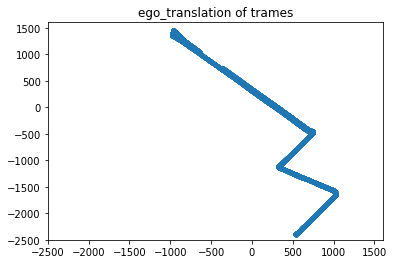

In [157]:
#ego_translation data
frames = zarr_dataset.frames
coords = frames["ego_translation"][:,:2]

plt.scatter(coords[:,0],coords[:,1], marker='.')
axes = plt.gca()
axes.set_xlim([-2500,1600])
axes.set_ylim([-2500,1600])

plt.title("ego_translation of trames")

In [ ]:
# EgoDataset: this dataset iterates over the AV (Autonomous Vehicle) annotations
# AgentDataset: this dataset iterates over other agents annotations

In [158]:
semantic_rasterizer = build_rasterizer(cfg, dm)
semantic_dataset = EgoDataset(cfg, zarr_dataset, semantic_rasterizer)

In [184]:
def plot_image(map_type, ax, agent=False):
    cfg["raster_params"]["map_type"] = map_type
    rast = build_rasterizer(cfg, dm)
    if agent:
        dataset = AgentDataset(cfg, zarr_dataset, rast)
    else:
        dataset = EgoDataset(cfg, zarr_dataset, rast)
    scene_idx = 2
    indexes = dataset.get_scene_indices(scene_idx)
    images = []
    for idx in indexes:    
        data = dataset[idx]
        im = data["image"].transpose(1, 2, 0)
        im = dataset.rasterizer.to_rgb(im)
        target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
        center_in_pixels = np.asarray(cfg["raster_params"]["ego_center"]) * cfg["raster_params"]["raster_size"]
        draw_trajectory(im, target_positions_pixels, TARGET_POINTS_COLOR, yaws=data["target_yaws"])
        clear_output(wait=True)
        ax.imshow(im[::-1])
def animate_solution(images):
    def animate(i):
        im.set_data(images[i]) 
    fig, ax = plt.subplots()
    im = ax.imshow(images[0])    
    return ani.FuncAnimation(fig, animate, frames=len(images), interval=60)

def animation(type_):
    cfg["raster_params"]["map_type"] = type_
    rast = build_rasterizer(cfg, dm)
    dataset = EgoDataset(cfg, zarr_dataset, rast)
    scene_idx = 34
    indexes = dataset.get_scene_indices(scene_idx)
    images = []
    for idx in indexes:    
        data = dataset[idx]
        im = data["image"].transpose(1, 2, 0)
        im = dataset.rasterizer.to_rgb(im)
        target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
        center_in_pixels = np.asarray(cfg["raster_params"]["ego_center"]) * cfg["raster_params"]["raster_size"]
        draw_trajectory(im, target_positions_pixels, TARGET_POINTS_COLOR, yaws=data["target_yaws"])
        clear_output(wait=True)
        images.append(PIL.Image.fromarray(im[::-1]))
    anim = animate_solution(images)
    return HTML(anim.to_jshtml())
    

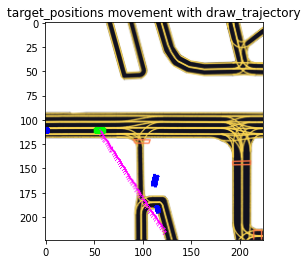

In [183]:
# Lyft l5kit also provides visualization functionallities. 
def visualize_trajectory(dataset, index, title="target_positions movement with draw_trajectory"):
    data = dataset[index]
    im = data["image"].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)
    target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
    draw_trajectory(im, target_positions_pixels, TARGET_POINTS_COLOR, yaws=data["target_yaws"])

    plt.title(title)
    plt.imshow(im[::-1])
    plt.show()


visualize_trajectory(semantic_dataset, index=0)

In [187]:
type(satellite_rasterizer), type(semantic_rasterizer)

(l5kit.rasterization.sat_box_rasterizer.SatBoxRasterizer,
 l5kit.rasterization.sem_box_rasterizer.SemBoxRasterizer)

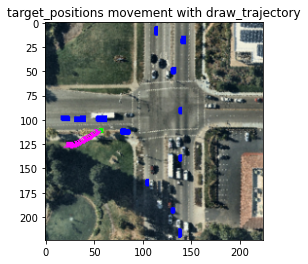

In [199]:
agent_dataset = AgentDataset(cfg, zarr_dataset, satellite_rasterizer)
visualize_trajectory(agent_dataset, index=523)

In [201]:
from IPython.display import display, clear_output
import PIL
 
dataset = semantic_dataset
scene_idx = 34
indexes = dataset.get_scene_indices(scene_idx)
images = []

for idx in indexes:
    data = dataset[idx]
    im = data["image"].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)
    target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
    center_in_pixels = np.asarray(cfg["raster_params"]["ego_center"]) * cfg["raster_params"]["raster_size"]
    draw_trajectory(im, target_positions_pixels, TARGET_POINTS_COLOR, yaws=data["target_yaws"])
    clear_output(wait=True)
    images.append(PIL.Image.fromarray(im[::-1]))

In [205]:
import matplotlib

In [206]:
%%capture
# From https://www.kaggle.com/jpbremer/lyft-scene-visualisations by @jpbremer
def animate_solution(images):

    def animate(i):
        im.set_data(images[i])
        return (im,)
 
    fig, ax = plt.subplots()
    im = ax.imshow(images[0])
    def init():
        im.set_data(images[0])
        return (im,)
    
    return matplotlib.animation.FuncAnimation(fig, animate, init_func=init, frames=len(images), interval=60, blit=True)

anim = animate_solution(images)

In [207]:
HTML(anim.to_jshtml())

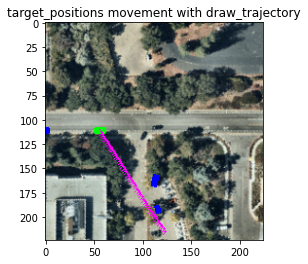

In [179]:
cfg["raster_params"]["map_type"] = "py_satellite"
satellite_rasterizer = build_rasterizer(cfg, dm)
satellite_dataset = EgoDataset(cfg, zarr_dataset, satellite_rasterizer)

visualize_trajectory(satellite_dataset, index=0)

In [119]:
a = semantic_dataset[0]